In [1]:
import pandas as pd
import geopandas as gpd

import matplotlib # base python plotting library
import matplotlib.pyplot as plt # submodule of matplotlib

# To display plots, maps, charts etc in the notebook
%matplotlib inline  
import math
import numpy as np

import matplotlib # base python plotting library
%matplotlib inline  
import matplotlib.pyplot as plt # more plotting stuff 

import folium # popular python web mapping tool for creating Leaflet maps
import folium.plugins

# Supress minor warnings about the syntax of CRS definitions, 
# ie "init=epsg:4269" vs "epsg:4269"
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
from geopandas import GeoDataFrame

In [2]:
zipbiz = round(pd.read_csv("pivot_table_zip.csv"))#.drop(['Unnamed: 0'], axis=1)#.rename(columns = {"ESTAB": "ESTAB COUNT"})

In [3]:
zipbiz = GeoDataFrame(zipbiz)
zipbiz["ZIPCODE"] = zipbiz["ZIPCODE"].astype(int)
zipbiz

,ZIPCODE,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study
0,94002,67.0,4.0,16.0,103,685,582
1,94005,10.0,0.0,0.0,20,283,263
2,94010,76.0,8.0,36.0,291,2252,1961
3,94014,79.0,6.0,6.0,128,621,493
4,94015,65.0,9.0,15.0,226,881,655
...,...,...,...,...,...,...,...
167,95002,4.0,0.0,0.0,4,64,60
168,95035,294.0,18.0,42.0,523,2279,1756
169,95134,58.0,0.0,3.0,61,661,600
170,95476,47.0,8.0,13.0,180,1194,1014


In [4]:
berkeley = gpd.read_file("zip://../POC Buisness/Archive.zip")  
berkeley["zip"] = berkeley["zip"].astype(int)

In [5]:
merged = zipbiz.merge(berkeley, how = "inner", right_on = "zip", left_on = "ZIPCODE").drop(["ZIPCODE"], axis = 1)
#merged.drop(merged[merged["Broad Industry"] =="0"].index, inplace = True)
merged

,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,zip,geometry
0,67.0,4.0,16.0,103,685,582,1.632100e+08,86346.487211,BELMONT,CA,94002,"POLYGON ((-122.33770 37.50626, -122.33815 37.5..."
1,10.0,0.0,0.0,20,283,263,1.323574e+08,67781.503917,BRISBANE,CA,94005,"POLYGON ((-122.39341 37.70829, -122.39411 37.7..."
2,76.0,8.0,36.0,291,2252,1961,3.590162e+08,141377.757027,BURLINGAME,CA,94010,"POLYGON ((-122.36133 37.53134, -122.36386 37.5..."
3,79.0,6.0,6.0,128,621,493,1.815553e+08,81604.628852,DALY CITY,CA,94014,"POLYGON ((-122.42930 37.68309, -122.42940 37.6..."
4,65.0,9.0,15.0,226,881,655,1.594835e+08,75079.285606,DALY CITY,CA,94015,"POLYGON ((-122.47190 37.64912, -122.47121 37.6..."
...,...,...,...,...,...,...,...,...,...,...,...,...
167,4.0,0.0,0.0,4,64,60,1.240214e+08,62725.596535,ALVISO,CA,95002,"POLYGON ((-121.96836 37.41882, -121.96922 37.4..."
168,294.0,18.0,42.0,523,2279,1756,1.364207e+09,238038.079652,MILPITAS,CA,95035,"POLYGON ((-121.91520 37.39611, -121.91527 37.3..."
169,58.0,0.0,3.0,61,661,600,3.108945e+08,121395.240015,SAN JOSE,CA,95134,"POLYGON ((-121.91520 37.39611, -121.91589 37.3..."
170,47.0,8.0,13.0,180,1194,1014,3.001414e+09,311318.546326,SONOMA,CA,95476,"POLYGON ((-122.40684 38.15568, -122.40757 38.1..."


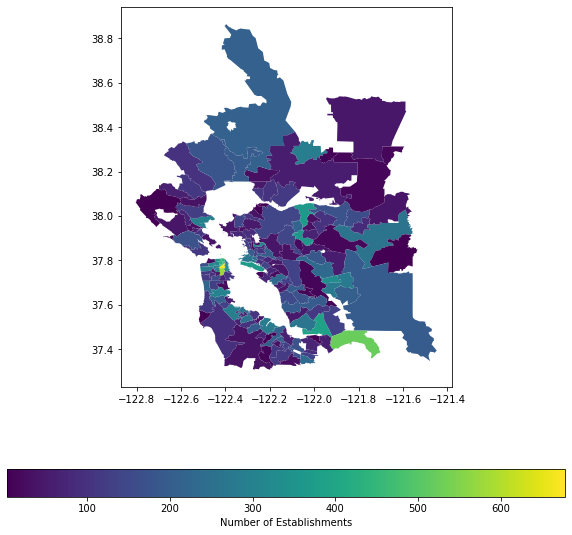

In [6]:
## Change the size by adding in some more matplotlib commands
fig, ax = plt.subplots(figsize = (10,10)) 
merged.plot(column='Our Industries', 
                    legend=True,
                    legend_kwds={'label': "Number of Establishments",
                                 'orientation': "horizontal"},
                    ax=ax)
plt.show()

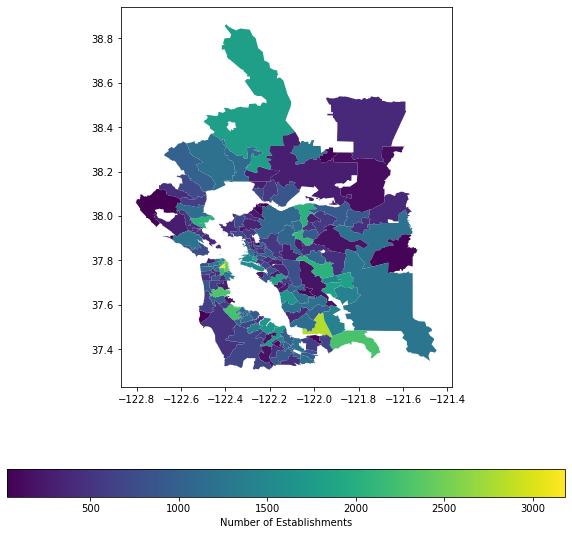

In [7]:
fig, ax = plt.subplots(figsize = (10,10)) 
merged.plot(column='Total Industries', 
                    legend=True,
                    legend_kwds={'label': "Number of Establishments",
                                 'orientation': "horizontal"},
                    ax=ax)
plt.show()

In [8]:
merged

,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,zip,geometry
0,67.0,4.0,16.0,103,685,582,1.632100e+08,86346.487211,BELMONT,CA,94002,"POLYGON ((-122.33770 37.50626, -122.33815 37.5..."
1,10.0,0.0,0.0,20,283,263,1.323574e+08,67781.503917,BRISBANE,CA,94005,"POLYGON ((-122.39341 37.70829, -122.39411 37.7..."
2,76.0,8.0,36.0,291,2252,1961,3.590162e+08,141377.757027,BURLINGAME,CA,94010,"POLYGON ((-122.36133 37.53134, -122.36386 37.5..."
3,79.0,6.0,6.0,128,621,493,1.815553e+08,81604.628852,DALY CITY,CA,94014,"POLYGON ((-122.42930 37.68309, -122.42940 37.6..."
4,65.0,9.0,15.0,226,881,655,1.594835e+08,75079.285606,DALY CITY,CA,94015,"POLYGON ((-122.47190 37.64912, -122.47121 37.6..."
...,...,...,...,...,...,...,...,...,...,...,...,...
167,4.0,0.0,0.0,4,64,60,1.240214e+08,62725.596535,ALVISO,CA,95002,"POLYGON ((-121.96836 37.41882, -121.96922 37.4..."
168,294.0,18.0,42.0,523,2279,1756,1.364207e+09,238038.079652,MILPITAS,CA,95035,"POLYGON ((-121.91520 37.39611, -121.91527 37.3..."
169,58.0,0.0,3.0,61,661,600,3.108945e+08,121395.240015,SAN JOSE,CA,95134,"POLYGON ((-121.91520 37.39611, -121.91589 37.3..."
170,47.0,8.0,13.0,180,1194,1014,3.001414e+09,311318.546326,SONOMA,CA,95476,"POLYGON ((-122.40684 38.15568, -122.40757 38.1..."


In [9]:
merged["x"] = merged.centroid.map(lambda p: p.x)
merged["y"] = merged.centroid.map(lambda p: p.y)

In [10]:
center_x = (max(merged["x"])+min(merged["x"]))/2
center_y = (max(merged["y"])+min(merged["y"]))/2

In [11]:
map1 = folium.Map(location=[center_y, center_x],   # lat, lon around which to center the map
                 tiles='CartoDB Positron',
                 #width=800,                        # the width & height of the output map
                 #height=600,                       # in pixels or in percent of available space
                 zoom_start=10) # the zoom level for the data to be displayed

In [12]:
merged.crs = "epsg:4326"

In [13]:
folium.GeoJson(merged).add_to(map1)
map1

In [14]:
merged["zip"]= merged["zip"].astype(str)

In [15]:
# Get our map center

# Create our base map
map2 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer
folium.Choropleth(geo_data=merged.set_index('zip'),   # The object with the geospatial data
           data=merged,                                 # The object with the attribute data (can be same)
           columns=['zip','Our Industries'],                      # the ID and data columns in the data objects
           key_on="feature.id",                             # the ID in the geo_data object (don't change)
           fill_color="Reds",                               # The color palette (or color map) - see help
           fill_opacity=0.65,
           line_color="grey",
           legend=True,
           legend_name="Our Industry Count",
          ).add_to(map2)

# Display the map
map2  

In [16]:
merged

,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,zip,geometry,x,y
0,67.0,4.0,16.0,103,685,582,1.632100e+08,86346.487211,BELMONT,CA,94002,"POLYGON ((-122.33770 37.50626, -122.33815 37.5...",-122.297802,37.513573
1,10.0,0.0,0.0,20,283,263,1.323574e+08,67781.503917,BRISBANE,CA,94005,"POLYGON ((-122.39341 37.70829, -122.39411 37.7...",-122.407776,37.687067
2,76.0,8.0,36.0,291,2252,1961,3.590162e+08,141377.757027,BURLINGAME,CA,94010,"POLYGON ((-122.36133 37.53134, -122.36386 37.5...",-122.366623,37.567384
3,79.0,6.0,6.0,128,621,493,1.815553e+08,81604.628852,DALY CITY,CA,94014,"POLYGON ((-122.42930 37.68309, -122.42940 37.6...",-122.446444,37.690882
4,65.0,9.0,15.0,226,881,655,1.594835e+08,75079.285606,DALY CITY,CA,94015,"POLYGON ((-122.47190 37.64912, -122.47121 37.6...",-122.480687,37.681342
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,4.0,0.0,0.0,4,64,60,1.240214e+08,62725.596535,ALVISO,CA,95002,"POLYGON ((-121.96836 37.41882, -121.96922 37.4...",-121.990979,37.446806
168,294.0,18.0,42.0,523,2279,1756,1.364207e+09,238038.079652,MILPITAS,CA,95035,"POLYGON ((-121.91520 37.39611, -121.91527 37.3...",-121.816777,37.437755
169,58.0,0.0,3.0,61,661,600,3.108945e+08,121395.240015,SAN JOSE,CA,95134,"POLYGON ((-121.91520 37.39611, -121.91589 37.3...",-121.945822,37.429495
170,47.0,8.0,13.0,180,1194,1014,3.001414e+09,311318.546326,SONOMA,CA,95476,"POLYGON ((-122.40684 38.15568, -122.40757 38.1...",-122.453897,38.251115


In [17]:
## You code here
# Get our map center

# Define the basemap
map1 = folium.Map(location=[center_y, center_x],   # lat, lon around which to center the map
                 tiles='CartoDB Positron',
                 width=1000,                        # the width & height of the output map
                 height=600,                       # in pixels
                 zoom_start=10)                    # the zoom level for the data to be displayed

# Add  the census tracts gdf layer
folium.GeoJson(merged,
               style_function = lambda x: {
                   'weight':2,
                   'color':"white",
                   'opacity':1,
                   'fillColor':"red",
                   'fillOpacity':0.6
               },
               
               tooltip=folium.GeoJsonTooltip(
                   fields=['zip','Our Industries', 'Food Services and Drinking Places'], 
                   aliases=['Zipcode', 'Establishment Count', "Food"],
                   labels=True,
                   localize=True
               ),
              ).add_to(map1)


map1

In [18]:
merged

,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,zip,geometry,x,y
0,67.0,4.0,16.0,103,685,582,1.632100e+08,86346.487211,BELMONT,CA,94002,"POLYGON ((-122.33770 37.50626, -122.33815 37.5...",-122.297802,37.513573
1,10.0,0.0,0.0,20,283,263,1.323574e+08,67781.503917,BRISBANE,CA,94005,"POLYGON ((-122.39341 37.70829, -122.39411 37.7...",-122.407776,37.687067
2,76.0,8.0,36.0,291,2252,1961,3.590162e+08,141377.757027,BURLINGAME,CA,94010,"POLYGON ((-122.36133 37.53134, -122.36386 37.5...",-122.366623,37.567384
3,79.0,6.0,6.0,128,621,493,1.815553e+08,81604.628852,DALY CITY,CA,94014,"POLYGON ((-122.42930 37.68309, -122.42940 37.6...",-122.446444,37.690882
4,65.0,9.0,15.0,226,881,655,1.594835e+08,75079.285606,DALY CITY,CA,94015,"POLYGON ((-122.47190 37.64912, -122.47121 37.6...",-122.480687,37.681342
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,4.0,0.0,0.0,4,64,60,1.240214e+08,62725.596535,ALVISO,CA,95002,"POLYGON ((-121.96836 37.41882, -121.96922 37.4...",-121.990979,37.446806
168,294.0,18.0,42.0,523,2279,1756,1.364207e+09,238038.079652,MILPITAS,CA,95035,"POLYGON ((-121.91520 37.39611, -121.91527 37.3...",-121.816777,37.437755
169,58.0,0.0,3.0,61,661,600,3.108945e+08,121395.240015,SAN JOSE,CA,95134,"POLYGON ((-121.91520 37.39611, -121.91589 37.3...",-121.945822,37.429495
170,47.0,8.0,13.0,180,1194,1014,3.001414e+09,311318.546326,SONOMA,CA,95476,"POLYGON ((-122.40684 38.15568, -122.40757 38.1...",-122.453897,38.251115


In [19]:
# Get our map center

map3 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  #width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer to the map
layer1 = folium.Choropleth(geo_data=merged[['zip','geometry']].set_index('zip'),
           data=merged,
           columns=['zip','Our Industries', "Food Services and Drinking Places", "Non-essential Retail", "Personal Care Services", "Not in Study"],
           fill_color="RdYlGn",
           fill_opacity=0.65,
           line_color="white", #"white",
           line_weight=1,
           line_opacity=1,
           key_on="feature.id",
           legend=True,
           legend_name="zip",
           highlight=True
          ).add_to(map3)

# ADD the same geodataframe to the map to display a tooltip
layer2 = folium.GeoJson(merged,
    style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
    tooltip=folium.GeoJsonTooltip(
        fields=['zip','Our Industries', "Food Services and Drinking Places", "Non-essential Retail","Personal Care Services", "Not in Study"], 
        aliases=['Zip Code', 'Establishment Count', "Food", "Retail", "Personal Care Services", "Not in Study"],
        labels=True,
        localize=True
    ),
    highlight_function=lambda x: {'weight':3,'color':'white'}
).add_to(map3)



map3  # show map

In [20]:
minority_table = pd.read_csv('minority_group_white_percentages').rename(columns={"MINORITYGROUPS_CAT.1": "Percentage"})
minority_table

,IND_GROUPS,MINORITYGROUPS_CAT,Percentage
0,FoodService_DrinkingPlace,Minority Group,41.393443
1,FoodService_DrinkingPlace,White,58.606557
2,NonEssential_Retail,Minority Group,28.260870
3,NonEssential_Retail,White,71.739130
4,Other_notinstudy,Minority Group,29.173577
5,Other_notinstudy,White,70.826423
6,Personalcare_Laundry,Minority Group,52.100840
7,Personalcare_Laundry,White,47.899160


In [21]:
food_percent = minority_table[(minority_table["IND_GROUPS"]=="FoodService_DrinkingPlace")&(minority_table["MINORITYGROUPS_CAT"]=="Minority Group")]["Percentage"][0]/100
retail_percent = minority_table[(minority_table["IND_GROUPS"]=="NonEssential_Retail")&(minority_table["MINORITYGROUPS_CAT"]=="Minority Group")]["Percentage"][2]/100
not_in_study_percent = minority_table[(minority_table["IND_GROUPS"]=="Other_notinstudy")&(minority_table["MINORITYGROUPS_CAT"]=="Minority Group")]["Percentage"][4]/100
personal_care_percent = minority_table[(minority_table["IND_GROUPS"]=="Personalcare_Laundry")&(minority_table["MINORITYGROUPS_CAT"]=="Minority Group")]["Percentage"][6]/100


In [22]:
merged

,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,zip,geometry,x,y
0,67.0,4.0,16.0,103,685,582,1.632100e+08,86346.487211,BELMONT,CA,94002,"POLYGON ((-122.33770 37.50626, -122.33815 37.5...",-122.297802,37.513573
1,10.0,0.0,0.0,20,283,263,1.323574e+08,67781.503917,BRISBANE,CA,94005,"POLYGON ((-122.39341 37.70829, -122.39411 37.7...",-122.407776,37.687067
2,76.0,8.0,36.0,291,2252,1961,3.590162e+08,141377.757027,BURLINGAME,CA,94010,"POLYGON ((-122.36133 37.53134, -122.36386 37.5...",-122.366623,37.567384
3,79.0,6.0,6.0,128,621,493,1.815553e+08,81604.628852,DALY CITY,CA,94014,"POLYGON ((-122.42930 37.68309, -122.42940 37.6...",-122.446444,37.690882
4,65.0,9.0,15.0,226,881,655,1.594835e+08,75079.285606,DALY CITY,CA,94015,"POLYGON ((-122.47190 37.64912, -122.47121 37.6...",-122.480687,37.681342
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,4.0,0.0,0.0,4,64,60,1.240214e+08,62725.596535,ALVISO,CA,95002,"POLYGON ((-121.96836 37.41882, -121.96922 37.4...",-121.990979,37.446806
168,294.0,18.0,42.0,523,2279,1756,1.364207e+09,238038.079652,MILPITAS,CA,95035,"POLYGON ((-121.91520 37.39611, -121.91527 37.3...",-121.816777,37.437755
169,58.0,0.0,3.0,61,661,600,3.108945e+08,121395.240015,SAN JOSE,CA,95134,"POLYGON ((-121.91520 37.39611, -121.91589 37.3...",-121.945822,37.429495
170,47.0,8.0,13.0,180,1194,1014,3.001414e+09,311318.546326,SONOMA,CA,95476,"POLYGON ((-122.40684 38.15568, -122.40757 38.1...",-122.453897,38.251115


In [23]:
merged["Minority Industry Food Services and Drinking Places"] = round(merged["Food Services and Drinking Places"]*food_percent)
merged["Minority Industry Non-essential Retail"] = round(merged["Non-essential Retail"]*retail_percent)
merged["Minority Industry Personal Care Services"] = round(merged["Personal Care Services"]*personal_care_percent)
merged["Minority Industry Not in Study"] = round(merged["Not in Study"]*not_in_study_percent)

In [25]:
# Get our map center

map3 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  #width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer to the map
layer1 = folium.Choropleth(geo_data=merged[['zip','geometry']].set_index('zip'),
           data=merged,
           columns=['zip','Our Industries', "Minority Industry Food Services and Drinking Places", "Minority Industry Non-essential Retail", "Minority Industry Personal Care Services", "Minority Industry Not in Study"],
           fill_color="Reds",
           fill_opacity=0.65,
           line_color="white", #"white",
           line_weight=1,
           line_opacity=1,
           key_on="feature.id",
           legend=True,
           legend_name="Count",
           highlight=True
          ).add_to(map3)

# ADD the same geodataframe to the map to display a tooltip
layer2 = folium.GeoJson(merged,
    style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
    tooltip=folium.GeoJsonTooltip(
        fields=['zip','Our Industries', "Minority Industry Food Services and Drinking Places", "Minority Industry Non-essential Retail", "Minority Industry Personal Care Services", "Minority Industry Not in Study"], 
        aliases=['Zip Code', 'Establishment Count', "Minority Owned Food Establishments", "Minority Owned Retail Establishments", "Minority Owned Personal Care Establishments", "Other Minority Owned Establishments"],
        labels=True,
        localize=True
    ),
    highlight_function=lambda x: {'weight':3,'color':'white'}
).add_to(map3)



map3  # show map

In [35]:
# Total our industries

map3 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  #width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer to the map
layer1 = folium.Choropleth(geo_data=merged[['zip','geometry']].set_index('zip'),
           data=merged,
           columns=['zip',"Minority Industry Food Services and Drinking Places", "Minority Industry Non-essential Retail", "Minority Industry Personal Care Services"],
           fill_color="Reds",
           fill_opacity=0.65,
           line_color="white", #"white",
           line_weight=1,
           line_opacity=1,
           key_on="feature.id",
           legend=True,
           legend_name="Count",
           highlight=True
          ).add_to(map3)

# ADD the same geodataframe to the map to display a tooltip
layer2 = folium.GeoJson(merged,
    style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
    tooltip=folium.GeoJsonTooltip(
        fields=['zip',"Minority Industry Food Services and Drinking Places", "Minority Industry Non-essential Retail", "Minority Industry Personal Care Services"], 
        aliases=['Zip Code', 'BIPOC Food Services', "BIPOC Non-Essential Retail", "BIPOC Personal Services"],
        labels=True,
        localize=True
    ),
    highlight_function=lambda x: {'weight':3,'color':'white'}
).add_to(map3)


map3  # show map

In [28]:
merged["BIPOC %"] = (merged["Minority Industry Food Services and Drinking Places"]+merged["Minority Industry Non-essential Retail"]+merged["Minority Industry Personal Care Services"])/merged["Our Industries"]*100
merged

,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,zip,geometry,x,y,Minority Industry Food Services and Drinking Places,Minority Industry Non-essential Retail,Minority Industry Personal Care Services,Minority Industry Not in Study,BIPOC %
0,67.0,4.0,16.0,103,685,582,1.632100e+08,86346.487211,BELMONT,CA,94002,"POLYGON ((-122.33770 37.50626, -122.33815 37.5...",-122.297802,37.513573,28.0,1.0,8.0,170.0,35.922330
1,10.0,0.0,0.0,20,283,263,1.323574e+08,67781.503917,BRISBANE,CA,94005,"POLYGON ((-122.39341 37.70829, -122.39411 37.7...",-122.407776,37.687067,4.0,0.0,0.0,77.0,20.000000
2,76.0,8.0,36.0,291,2252,1961,3.590162e+08,141377.757027,BURLINGAME,CA,94010,"POLYGON ((-122.36133 37.53134, -122.36386 37.5...",-122.366623,37.567384,31.0,2.0,19.0,572.0,17.869416
3,79.0,6.0,6.0,128,621,493,1.815553e+08,81604.628852,DALY CITY,CA,94014,"POLYGON ((-122.42930 37.68309, -122.42940 37.6...",-122.446444,37.690882,33.0,2.0,3.0,144.0,29.687500
4,65.0,9.0,15.0,226,881,655,1.594835e+08,75079.285606,DALY CITY,CA,94015,"POLYGON ((-122.47190 37.64912, -122.47121 37.6...",-122.480687,37.681342,27.0,3.0,8.0,191.0,16.814159
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,4.0,0.0,0.0,4,64,60,1.240214e+08,62725.596535,ALVISO,CA,95002,"POLYGON ((-121.96836 37.41882, -121.96922 37.4...",-121.990979,37.446806,2.0,0.0,0.0,18.0,50.000000
168,294.0,18.0,42.0,523,2279,1756,1.364207e+09,238038.079652,MILPITAS,CA,95035,"POLYGON ((-121.91520 37.39611, -121.91527 37.3...",-121.816777,37.437755,122.0,5.0,22.0,512.0,28.489484
169,58.0,0.0,3.0,61,661,600,3.108945e+08,121395.240015,SAN JOSE,CA,95134,"POLYGON ((-121.91520 37.39611, -121.91589 37.3...",-121.945822,37.429495,24.0,0.0,2.0,175.0,42.622951
170,47.0,8.0,13.0,180,1194,1014,3.001414e+09,311318.546326,SONOMA,CA,95476,"POLYGON ((-122.40684 38.15568, -122.40757 38.1...",-122.453897,38.251115,19.0,2.0,7.0,296.0,15.555556


In [36]:
# Percentages in our industry

map3 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  #width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer to the map
layer1 = folium.Choropleth(geo_data=merged[['zip','geometry']].set_index('zip'),
           data=merged,
           columns=['zip',"BIPOC %"],
           fill_color="Reds",
           fill_opacity=0.65,
           line_color="white", #"white",
           line_weight=1,
           line_opacity=1,
           key_on="feature.id",
           legend=True,
           legend_name="BIPOC as % of Non-Essential Retail, Food and Beverage and Personal Services",
           highlight=True
          ).add_to(map3)

# ADD the same geodataframe to the map to display a tooltip
layer2 = folium.GeoJson(merged,
    style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
    tooltip=folium.GeoJsonTooltip(
        fields=['zip',"BIPOC %"], 
        aliases=['Zip Code', 'BIPOC as % of Non-Essential Retail, Food and Beverage and Personal Services'],
        labels=True,
        localize=True
    ),
    highlight_function=lambda x: {'weight':3,'color':'white'}
).add_to(map3)



map3  # show map

In [38]:
merged["BIPOC % Not in Study"] = merged["Minority Industry Not in Study"]/merged["Not in Study"]*100
merged

,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,zip,geometry,x,y,Minority Industry Food Services and Drinking Places,Minority Industry Non-essential Retail,Minority Industry Personal Care Services,Minority Industry Not in Study,BIPOC %,BIPOC % Not in Study
0,67.0,4.0,16.0,103,685,582,1.632100e+08,86346.487211,BELMONT,CA,94002,"POLYGON ((-122.33770 37.50626, -122.33815 37.5...",-122.297802,37.513573,28.0,1.0,8.0,170.0,35.922330,29.209622
1,10.0,0.0,0.0,20,283,263,1.323574e+08,67781.503917,BRISBANE,CA,94005,"POLYGON ((-122.39341 37.70829, -122.39411 37.7...",-122.407776,37.687067,4.0,0.0,0.0,77.0,20.000000,29.277567
2,76.0,8.0,36.0,291,2252,1961,3.590162e+08,141377.757027,BURLINGAME,CA,94010,"POLYGON ((-122.36133 37.53134, -122.36386 37.5...",-122.366623,37.567384,31.0,2.0,19.0,572.0,17.869416,29.168791
3,79.0,6.0,6.0,128,621,493,1.815553e+08,81604.628852,DALY CITY,CA,94014,"POLYGON ((-122.42930 37.68309, -122.42940 37.6...",-122.446444,37.690882,33.0,2.0,3.0,144.0,29.687500,29.208925
4,65.0,9.0,15.0,226,881,655,1.594835e+08,75079.285606,DALY CITY,CA,94015,"POLYGON ((-122.47190 37.64912, -122.47121 37.6...",-122.480687,37.681342,27.0,3.0,8.0,191.0,16.814159,29.160305
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,4.0,0.0,0.0,4,64,60,1.240214e+08,62725.596535,ALVISO,CA,95002,"POLYGON ((-121.96836 37.41882, -121.96922 37.4...",-121.990979,37.446806,2.0,0.0,0.0,18.0,50.000000,30.000000
168,294.0,18.0,42.0,523,2279,1756,1.364207e+09,238038.079652,MILPITAS,CA,95035,"POLYGON ((-121.91520 37.39611, -121.91527 37.3...",-121.816777,37.437755,122.0,5.0,22.0,512.0,28.489484,29.157175
169,58.0,0.0,3.0,61,661,600,3.108945e+08,121395.240015,SAN JOSE,CA,95134,"POLYGON ((-121.91520 37.39611, -121.91589 37.3...",-121.945822,37.429495,24.0,0.0,2.0,175.0,42.622951,29.166667
170,47.0,8.0,13.0,180,1194,1014,3.001414e+09,311318.546326,SONOMA,CA,95476,"POLYGON ((-122.40684 38.15568, -122.40757 38.1...",-122.453897,38.251115,19.0,2.0,7.0,296.0,15.555556,29.191321


In [39]:
# Count not in industires

map3 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  #width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer to the map
layer1 = folium.Choropleth(geo_data=merged[['zip','geometry']].set_index('zip'),
           data=merged,
           columns=['zip',"Minority Industry Not in Study"],
           fill_color="Blues",
           fill_opacity=0.65,
           line_color="white", #"white",
           line_weight=1,
           line_opacity=1,
           key_on="feature.id",
           legend=True,
           legend_name="Count",
           highlight=True
          ).add_to(map3)

# ADD the same geodataframe to the map to display a tooltip
layer2 = folium.GeoJson(merged,
    style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
    tooltip=folium.GeoJsonTooltip(
        fields=['zip',"Minority Industry Not in Study"], 
        aliases=['Zip Code', 'BIPOC of all Other Industries'],
        labels=True,
        localize=True
    ),
    highlight_function=lambda x: {'weight':3,'color':'white'}
).add_to(map3)



map3  # show map

In [40]:
# Percentages not in study

map3 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  #width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer to the map
layer1 = folium.Choropleth(geo_data=merged[['zip','geometry']].set_index('zip'),
           data=merged,
           columns=['zip',"BIPOC % Not in Study"],
           fill_color="Blues",
           fill_opacity=0.65,
           line_color="white", #"white",
           line_weight=1,
           line_opacity=1,
           key_on="feature.id",
           legend=True,
           legend_name="BIPOC as a % of all Other Industries",
           highlight=True
          ).add_to(map3)

# ADD the same geodataframe to the map to display a tooltip
layer2 = folium.GeoJson(merged,
    style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
    tooltip=folium.GeoJsonTooltip(
        fields=['zip',"BIPOC % Not in Study"], 
        aliases=['Zip Code', 'BIPOC % Not in Study'],
        labels=True,
        localize=True
    ),
    highlight_function=lambda x: {'weight':3,'color':'white'}
).add_to(map3)



map3  # show map

In [41]:
merged.head(0)

,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,zip,geometry,x,y,Minority Industry Food Services and Drinking Places,Minority Industry Non-essential Retail,Minority Industry Personal Care Services,Minority Industry Not in Study,BIPOC %,BIPOC % Not in Study


In [42]:
merged["BIPOC Total"] = merged["Minority Industry Food Services and Drinking Places"]+merged["Minority Industry Non-essential Retail"]+merged["Minority Industry Personal Care Services"]+merged["Minority Industry Not in Study"]
merged



,Food Services and Drinking Places,Non-essential Retail,Personal Care Services,Our Industries,Total Industries,Not in Study,area,length,po_name,state,...,geometry,x,y,Minority Industry Food Services and Drinking Places,Minority Industry Non-essential Retail,Minority Industry Personal Care Services,Minority Industry Not in Study,BIPOC %,BIPOC % Not in Study,BIPOC Total
0,67.0,4.0,16.0,103,685,582,1.632100e+08,86346.487211,BELMONT,CA,...,"POLYGON ((-122.33770 37.50626, -122.33815 37.5...",-122.297802,37.513573,28.0,1.0,8.0,170.0,35.922330,29.209622,207.0
1,10.0,0.0,0.0,20,283,263,1.323574e+08,67781.503917,BRISBANE,CA,...,"POLYGON ((-122.39341 37.70829, -122.39411 37.7...",-122.407776,37.687067,4.0,0.0,0.0,77.0,20.000000,29.277567,81.0
2,76.0,8.0,36.0,291,2252,1961,3.590162e+08,141377.757027,BURLINGAME,CA,...,"POLYGON ((-122.36133 37.53134, -122.36386 37.5...",-122.366623,37.567384,31.0,2.0,19.0,572.0,17.869416,29.168791,624.0
3,79.0,6.0,6.0,128,621,493,1.815553e+08,81604.628852,DALY CITY,CA,...,"POLYGON ((-122.42930 37.68309, -122.42940 37.6...",-122.446444,37.690882,33.0,2.0,3.0,144.0,29.687500,29.208925,182.0
4,65.0,9.0,15.0,226,881,655,1.594835e+08,75079.285606,DALY CITY,CA,...,"POLYGON ((-122.47190 37.64912, -122.47121 37.6...",-122.480687,37.681342,27.0,3.0,8.0,191.0,16.814159,29.160305,229.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,4.0,0.0,0.0,4,64,60,1.240214e+08,62725.596535,ALVISO,CA,...,"POLYGON ((-121.96836 37.41882, -121.96922 37.4...",-121.990979,37.446806,2.0,0.0,0.0,18.0,50.000000,30.000000,20.0
168,294.0,18.0,42.0,523,2279,1756,1.364207e+09,238038.079652,MILPITAS,CA,...,"POLYGON ((-121.91520 37.39611, -121.91527 37.3...",-121.816777,37.437755,122.0,5.0,22.0,512.0,28.489484,29.157175,661.0
169,58.0,0.0,3.0,61,661,600,3.108945e+08,121395.240015,SAN JOSE,CA,...,"POLYGON ((-121.91520 37.39611, -121.91589 37.3...",-121.945822,37.429495,24.0,0.0,2.0,175.0,42.622951,29.166667,201.0
170,47.0,8.0,13.0,180,1194,1014,3.001414e+09,311318.546326,SONOMA,CA,...,"POLYGON ((-122.40684 38.15568, -122.40757 38.1...",-122.453897,38.251115,19.0,2.0,7.0,296.0,15.555556,29.191321,324.0


In [48]:
# Count all in industires

map3 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  #width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer to the map
layer1 = folium.Choropleth(geo_data=merged[['zip','geometry']].set_index('zip'),
           data=merged,
           columns=['zip',"BIPOC Total"],
           fill_color="Blues",
           fill_opacity=0.65,
           line_color="white", #"white",
           line_weight=1,
           line_opacity=1,
           key_on="feature.id",
           legend=True,
           legend_name="Count",
           highlight=True
          ).add_to(map3)

# ADD the same geodataframe to the map to display a tooltip
layer2 = folium.GeoJson(merged,
    style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
    tooltip=folium.GeoJsonTooltip(
        fields=['zip',"BIPOC Total"], 
        aliases=['Zip Code', 'BIPOC of all Industries'],
        labels=True,
        localize=True
    ),
    highlight_function=lambda x: {'weight':3,'color':'white'}
).add_to(map3)



map3  # show map

In [46]:
merged["BIPOC Total %"] =merged["BIPOC Total"]/merged["Total Industries"]*100

In [49]:
# Percentages all in study

map3 = folium.Map(location=[center_y, center_x], 
                  tiles='CartoDB Positron',
                  #width=800,height=600,
                  zoom_start=10)

# Add the Choropleth layer to the map
layer1 = folium.Choropleth(geo_data=merged[['zip','geometry']].set_index('zip'),
           data=merged,
           columns=['zip',"BIPOC Total %"],
           fill_color="Blues",
           fill_opacity=0.65,
           line_color="white", #"white",
           line_weight=1,
           line_opacity=1,
           key_on="feature.id",
           legend=True,
           legend_name="BIPOC as a % of all Industries",
           highlight=True
          ).add_to(map3)

# ADD the same geodataframe to the map to display a tooltip
layer2 = folium.GeoJson(merged,
    style_function=lambda x: {'color':'transparent','fillColor':'transparent'},
    tooltip=folium.GeoJsonTooltip(
        fields=['zip',"BIPOC Total %"], 
        aliases=['Zip Code', 'BIPOC Total %'],
        labels=True,
        localize=True
    ),
    highlight_function=lambda x: {'weight':3,'color':'white'}
).add_to(map3)



map3  # show map